### CellSAM Segmentation

#### Understanding the Anndata object

In [2]:
import numpy as np
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import openslide
from PIL import Image
import tifffile
from cellSAM import segment_cellular_image   
import scipy.sparse as sp
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
import json
import anndata as ad
from skimage.measure import regionprops
from scipy.spatial import KDTree
from scipy.sparse import lil_matrix, csr_matrix


In [ ]:
adata = sc.read_h5ad("gvhd-project_adata_folder_adata_integrate_final_hub_cell_type.h5ad")
adata_slv14 = adata[adata.obs["sample"] == "SLV14", :].copy()
print(adata_slv14.obsm["spatial"].shape)
print(adata_slv14.obsm["spatial"][:5])

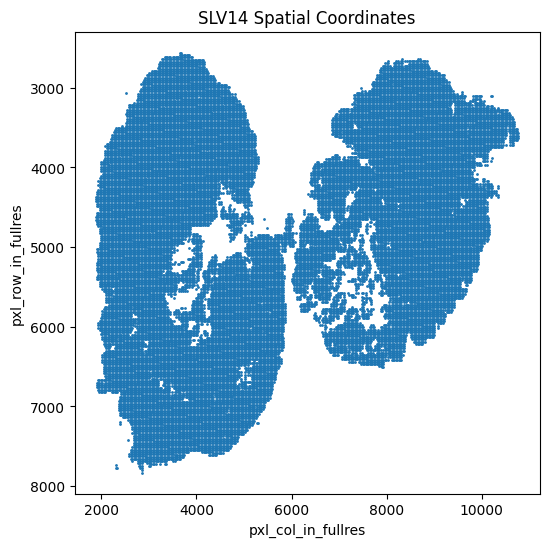

In [2]:
# Visualize the spatial coordinates
coords = adata_slv14.obsm["spatial"]

plt.figure(figsize=(6, 6))
plt.scatter(coords[:, 0], coords[:, 1], s=1)
plt.gca().invert_yaxis()
plt.title("SLV14 Spatial Coordinates")
plt.xlabel("pxl_col_in_fullres")
plt.ylabel("pxl_row_in_fullres")
plt.show()

#### Map the AnnData coordinates to the high-res histology image

In [ ]:
# Load the full-resolution SVS file
svs_file_path = "/Users/adyzhang/gvhd_spatial/#38_C159_1_F1_Slide2.svs"
slide = openslide.OpenSlide(svs_file_path)
full_width, full_height = slide.dimensions
print(f"Full image dimensions: {full_width} x {full_height}")

# Load the hires img
img = adata.uns["spatial"]["SLV14"]["images"]["hires"]
print(img.shape) 
print(slide.dimensions) 

# Load the Anndata spatial coords
coords = adata_slv14.obsm["spatial"]
print("Coordinate ranges:", coords[:, 0].min(), coords[:, 0].max(), coords[:, 1].min(), coords[:, 1].max())

# Map Anndata spatial coords to hires image
scale_factor = 0.5097273 # tissue_hires_scalef
coords_visium = adata_slv14.obsm["spatial"]
coords_img = coords_visium * scale_factor

Full image dimensions: 25896 x 18389
(4261, 6000, 3)
(25896, 18389)
Coordinate ranges: 1884.0 10769.0 2558.0 7831.0


In [4]:
# Map hires image coords to full-res .svs space
slide = openslide.OpenSlide(svs_file_path)
hires_img = adata.uns["spatial"]["SLV14"]["images"]["hires"]

# Dimensions
hires_height, hires_width = hires_img.shape[:2]
svs_width, svs_height = slide.dimensions

# Scaling factors
scale_x = svs_width / hires_width
scale_y = svs_height / hires_height
print(f"scale_x = {scale_x:.4f}, scale_y = {scale_y:.4f}")

# Scale the coords
coords_visium = adata_slv14.obsm["spatial"]
coords_hires = coords_visium * 0.5097273
coords_svs = coords_hires * [scale_x, scale_y]

# Define thumbnail size for visualzation
thumb_width = 3000
thumb_height = int(thumb_width * svs_height / svs_width)
thumbnail = slide.get_thumbnail((thumb_width, thumb_height)).convert("RGB")
coords_thumb = coords_svs.copy()
coords_thumb[:, 0] *= thumb_width / svs_width
coords_thumb[:, 1] *= thumb_height / svs_height

scale_x = 4.3160, scale_y = 4.3157


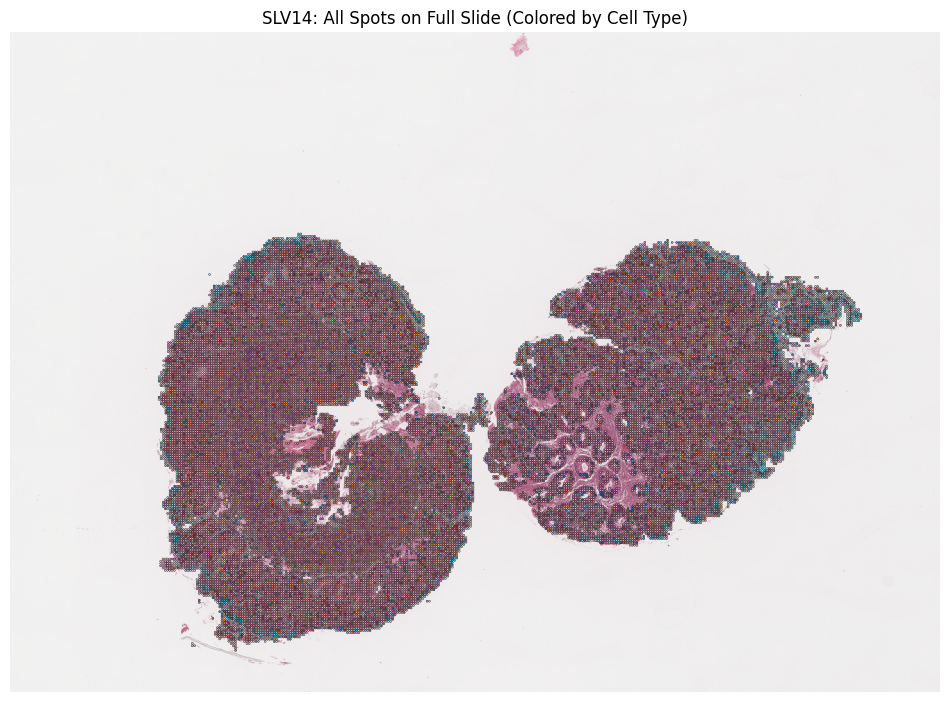

In [5]:
# Plot the thumbnail colored by hub cell types
celltypes = adata_slv14.obs["hub_celltype"].astype("category")
colors = celltypes.cat.codes
cmap = plt.get_cmap("tab20")

plt.figure(figsize=(12, 12))
plt.imshow(thumbnail)
plt.scatter(
    coords_thumb[:, 0],
    coords_thumb[:, 1],
    c=colors,
    cmap=cmap,
    s=2,
    alpha=0.85,
    edgecolors="black",
    linewidths=0.3
)
plt.axis("off")
plt.title("SLV14: All Spots on Full Slide (Colored by Cell Type)")
plt.show()

#### Select a patch from the sample to perform the segmentation

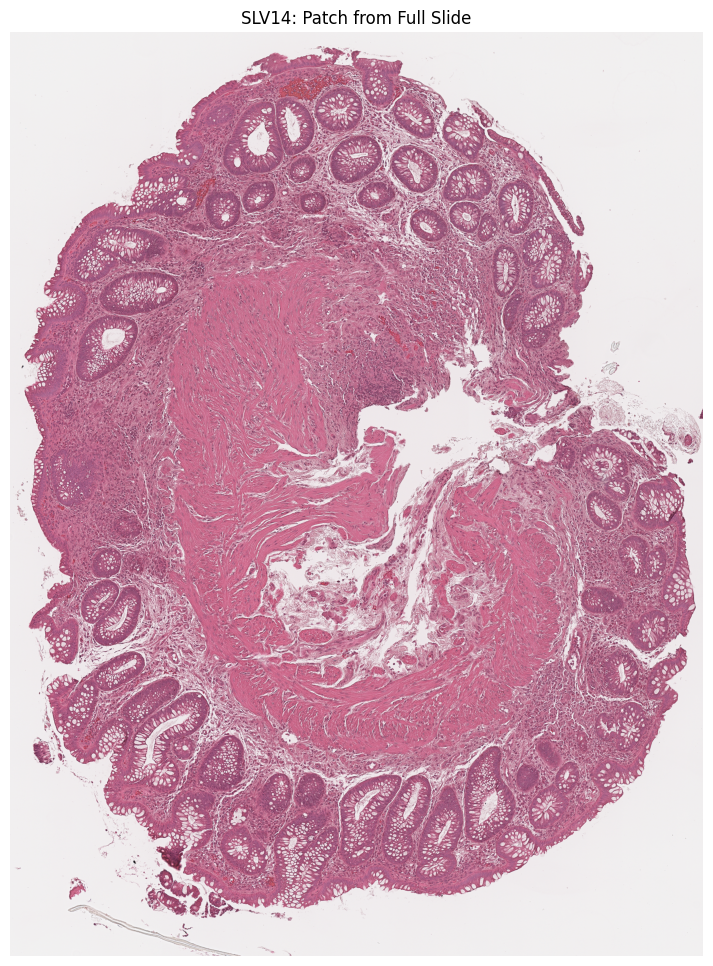

In [6]:
# Define the patch
patch_x, patch_y = 4000,  5500    # top‑left corner 
patch_w, patch_h = 9000,  12000    # width & height 

# Read & save the patch
patch = slide.read_region((patch_x, patch_y), 0, (patch_w, patch_h)).convert("RGB")
# patch.save("patch.png")
# print(f"Saved patch.png ({patch_w}×{patch_h})")

plt.figure(figsize=(12, 12))
plt.imshow(patch)
plt.axis("off")
plt.title("SLV14: Patch from Full Slide")
plt.show()

#### Segment the patch in tiles using CellSAM and stitch the tile masks into full mask 

In [ ]:
tile_size = 2000  # max patch size for CellSAM to perform well 

x_starts = list(range(patch_x, patch_x + patch_w, tile_size))
y_starts = list(range(patch_y, patch_y + patch_h, tile_size))

tiles = []
for y0 in y_starts:
    for x0 in x_starts:
        # Compute width/height for the tile
        w = min(tile_size, patch_x + patch_w - x0)
        h = min(tile_size, patch_y + patch_h - y0)
        tiles.append((x0, y0, w, h))

In [ ]:
full_mask = np.zeros((patch_h, patch_w), dtype=np.int32)
label_counter = 1

for (x0, y0, w, h) in tiles:
    patch = slide.read_region((x0, y0), level=0, size=(w, h)).convert("RGB")
    patch_arr = np.array(patch)

    # Skip empty (white) patches
    if (patch_arr.mean(axis=2) > 240).sum() > 0.99 * w * h:
        continue

    # Segment with CellSAM
    try:
        mask, _, _ = segment_cellular_image(patch_arr, device="cpu")
    except Exception as e:
        print(f"Segmentation failed at ({x0}, {y0}): {e}")
        continue

    # Skip if segmentation returned None
    if mask is None:
        print(f"No mask returned for patch at ({x0}, {y0})")
        continue
    
    # Ensure unique labels
    mask = np.where(mask > 0, mask + label_counter, 0)
    label_counter = mask.max() + 1

    # Insert into full_mask
    insert_x = x0 - patch_x
    insert_y = y0 - patch_y
    full_mask[insert_y:insert_y + h, insert_x:insert_x + w] = np.where(
        mask > 0,
        mask,
        full_mask[insert_y:insert_y + h, insert_x:insert_x + w]
    )
    print("Processed patch at ({}, {})".format(x0, y0))

Processed patch at (4000, 5500)
Processed patch at (6000, 5500)


/Applications/anaconda3/envs/cellsam/lib/python3.12/site-packages/cellSAM/sam_inference.py:272: UserWarning: Low IOU threshold, ignoring mask.
  warnings.warn("Low IOU threshold, ignoring mask.")


Processed patch at (8000, 5500)
Processed patch at (10000, 5500)
Segmentation failed at (12000, 5500): 'NoneType' object has no attribute 'ndim'
Processed patch at (4000, 7500)
Processed patch at (6000, 7500)
Processed patch at (8000, 7500)
Processed patch at (10000, 7500)
Processed patch at (12000, 7500)
Processed patch at (4000, 9500)
Processed patch at (6000, 9500)
Processed patch at (8000, 9500)
Processed patch at (10000, 9500)
Processed patch at (12000, 9500)
Processed patch at (4000, 11500)
Processed patch at (6000, 11500)
Processed patch at (8000, 11500)
Processed patch at (10000, 11500)
Processed patch at (12000, 11500)
Processed patch at (4000, 13500)
Processed patch at (6000, 13500)
Processed patch at (8000, 13500)
Processed patch at (10000, 13500)
Processed patch at (12000, 13500)
Processed patch at (4000, 15500)
Processed patch at (6000, 15500)
Processed patch at (8000, 15500)
Processed patch at (10000, 15500)
Segmentation failed at (12000, 15500): 'NoneType' object has no 

In [ ]:
print(f"full_mask shape: {full_mask.shape}")
print(f"Expected shape: ({patch_h}, {patch_w})")
assert full_mask.shape == (patch_h, patch_w), "Mismatch in mask size!"

full_mask shape: (12000, 9000)
Expected shape: (12000, 9000)


In [ ]:
# # Write the full mask into a TIFF file
# output_path = "stitched_cellsam_mask_full.tiff"
# tifffile.imwrite(output_path, full_mask.astype(np.uint16))  # use uint16 to support many labels
# print(f"Saved stitched mask to: {output_path}")

In [12]:
# Read the saved mask
full_mask = tifffile.imread("stitched_cellsam_mask_full.tiff")
print("Mask shape:", full_mask.shape)
print("Data type:", full_mask.dtype)

Mask shape: (12000, 9000)
Data type: uint16


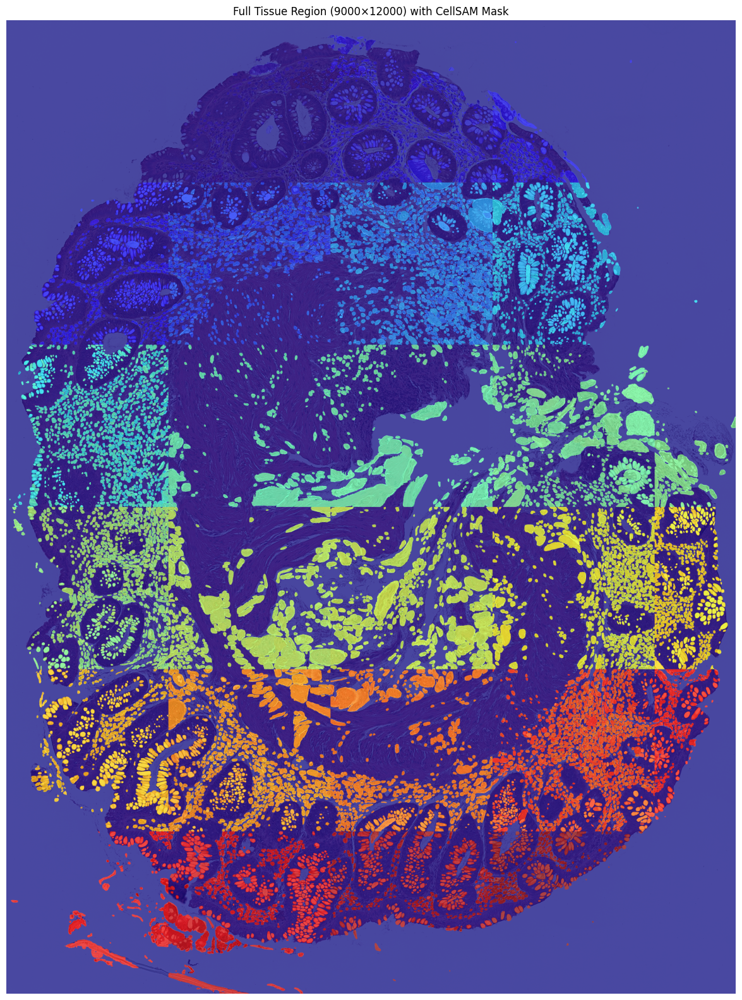

In [13]:
# Visualize the full mask over the histology
histology_patch = slide.read_region(
    (patch_x, patch_y), level=0, size=(patch_w, patch_h)
).convert("RGB")

histology_array = np.array(histology_patch)

plt.figure(figsize=(20, 20))
plt.imshow(histology_array)                     
plt.imshow(full_mask, cmap="jet", alpha=0.7)    
plt.title(f"Full Tissue Region ({patch_w}×{patch_h}) with CellSAM Mask")
plt.axis("off")
plt.show()

#### Visualize top gene counts in the segmented patch

In [ ]:
# Build mask of spots inside patch 
inside = (
    (coords_svs[:, 0] >= patch_x) & (coords_svs[:, 0] < patch_x + patch_w) &
    (coords_svs[:, 1] >= patch_y) & (coords_svs[:, 1] < patch_y + patch_h)
)
n_spots_in_patch = inside.sum()
if n_spots_in_patch == 0:
    raise RuntimeError("No spots fall inside the specified patch. "
                       "Re‑check patch_x / patch_y or coords_svs.")
    

adata_patch = adata_slv14[inside]

# If the matrix is sparse, convert to 1D numpy array of sums
if sp.issparse(adata_patch.X):
    gene_sums = np.array(adata_patch.X.sum(axis=0)).ravel()
else:
    gene_sums = adata_patch.X.sum(axis=0)

# Build a tidy table
df = pd.DataFrame({
    "gene": adata_patch.var_names,
    "total_counts_in_patch": gene_sums
}).sort_values("total_counts_in_patch", ascending=False)

df.head(20)

,gene,total_counts_in_patch
757,PIGR,243881.0
712,OLFM4,78286.0
1037,TMSB4X,72301.0
654,MUC12,66220.0
306,DES,60805.0
202,CEACAM5,34504.0
755,PI3,33161.0
995,TAGLN,32061.0
656,MUC2,27487.0
1016,TFF3,26318.0


Visualize the spots (16 micron VisiumHD) in the segmented patch

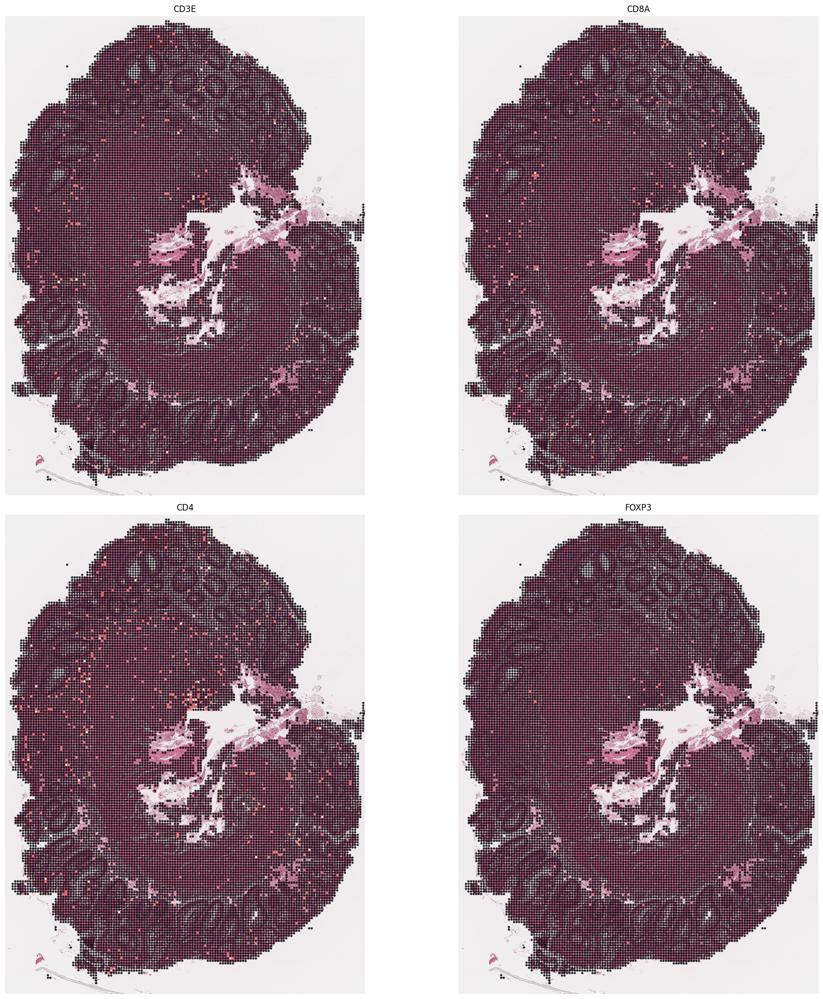

In [23]:
genes_to_plot = ["CD3E", "CD8A", "CD4", "FOXP3"] # t cell signatures, can also plot the top genes in segmented patch
spot_size = 10   
gene_idx = {g: np.where(adata_slv14.var_names == g)[0][0] for g in genes_to_plot}

inside = (
    (coords_svs[:, 0] >= patch_x) & (coords_svs[:, 0] < patch_x + patch_w) &
    (coords_svs[:, 1] >= patch_y) & (coords_svs[:, 1] < patch_y + patch_h)
)
coords_local = coords_svs[inside].copy()
coords_local[:, 0] -= patch_x
coords_local[:, 1] -= patch_y

X_patch = adata_slv14.X[inside]     

def plot_gene(ax, gene, vmax=None):
    gexpr = (
        X_patch[:, gene_idx[gene]].toarray().ravel()
        if hasattr(X_patch, "toarray") else
        X_patch[:, gene_idx[gene]]
    )
    gexpr_log = np.log1p(gexpr)
    if vmax is None:
        vmax = np.percentile(gexpr_log, 99)   
    cmap = plt.cm.magma
    norm = mcolors.Normalize(vmin=0, vmax=1)
    
    ax.imshow(patch)
    ax.scatter(
        coords_local[:, 0], coords_local[:, 1],
        c=gexpr_log, cmap=cmap, norm=norm,
        s=spot_size, alpha=0.85, edgecolors="none"
    )
    ax.set_title(gene)
    ax.axis("off")

n = len(genes_to_plot)
ncols = 2
nrows = int(np.ceil(n / ncols))
fig, axes = plt.subplots(nrows, ncols, figsize=(10*ncols, 10*nrows))
axes = np.ravel(axes)
for ax, gene in zip(axes, genes_to_plot):
    plot_gene(ax, gene)
for ax in axes[n:]:
    ax.remove()
plt.tight_layout()
plt.show()

Check whether the spots are falling inside the segmented mask

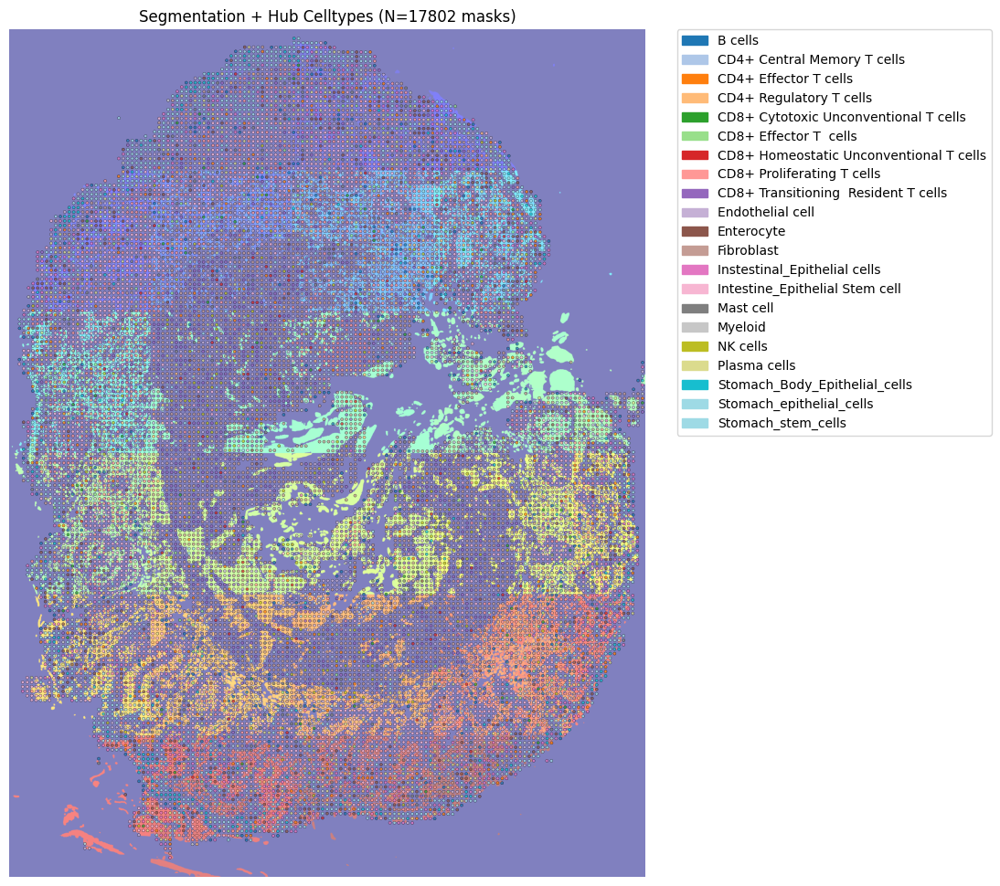

In [30]:
hub_celltypes = adata_slv14.obs["hub_celltype"].astype("category")
cell_codes    = hub_celltypes.cat.codes[inside]
cell_labels   = hub_celltypes.cat.categories
colors        = plt.get_cmap("tab20")(np.linspace(0, 1, len(cell_labels)))

handles = [
    mpatches.Patch(color=colors[i], label=cell_labels[i])
    for i in range(len(cell_labels))
]

plt.figure(figsize=(10, 10))
plt.imshow(full_mask, cmap="jet", alpha=0.5)
plt.scatter(
    coords_local[:, 0], coords_local[:, 1],
    c=cell_codes, cmap="tab20",
    s=5, edgecolors="black", linewidths=0.25, alpha=0.75
)

plt.axis("off")
plt.title(f"Segmentation + Hub Celltypes (N={full_mask.max()} masks)")
plt.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc="upper left", borderaxespad=0.)
plt.tight_layout()
plt.show()

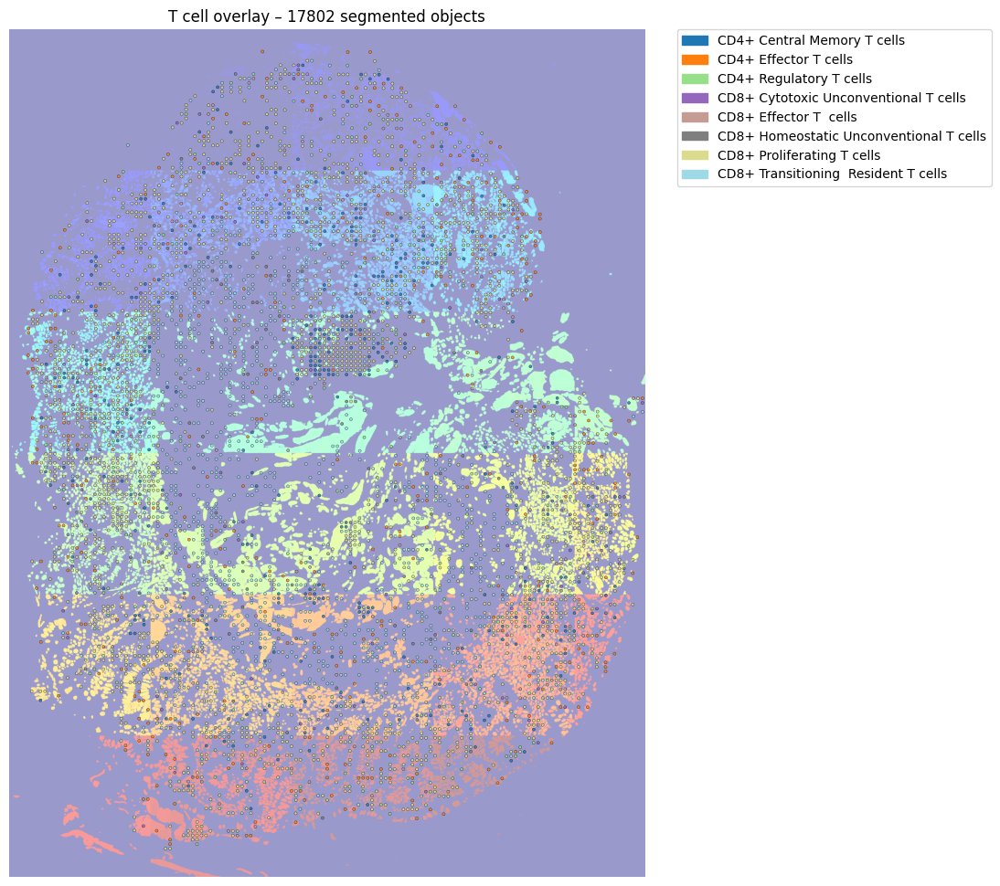

In [31]:
tcell_types = [
    'CD8+ Effector T  cells',
    'CD4+ Effector T cells',
    'CD4+ Central Memory T cells',
    'CD8+ Cytotoxic Unconventional T cells',
    'CD8+ Proliferating T cells',
    'CD4+ Regulatory T cells',
    'CD8+ Homeostatic Unconventional T cells',
    'CD8+ Tissue Resident Memory T cells',
    'CD8+ Transitioning  Resident T cells'
]

hub = adata_slv14.obs["hub_celltype"]
inside_tcells = inside & hub.isin(tcell_types)

coords_t = coords_svs[inside_tcells].copy()
coords_t[:, 0] -= patch_x
coords_t[:, 1] -= patch_y

hub_t = hub[inside_tcells].astype("category").cat.remove_unused_categories()
cell_codes_t = hub_t.cat.codes
cell_labels_t = hub_t.cat.categories
colors_t = plt.get_cmap("tab20")(np.linspace(0, 1, len(cell_labels_t)))

handles = [
    mpatches.Patch(color=colors_t[i], label=cell_labels_t[i])
    for i in range(len(cell_labels_t))
]


plt.figure(figsize=(10, 10))
plt.imshow(full_mask, cmap="jet", alpha=0.4)
plt.scatter(
    coords_t[:, 0], coords_t[:, 1],
    c=cell_codes_t, cmap="tab20",
    s=5, edgecolors="black", linewidths=0.25, alpha=0.8
)
plt.axis("off")
plt.title(f"T cell overlay – {full_mask.max()} segmented objects")
plt.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc="upper left", borderaxespad=0.)
plt.tight_layout()
plt.show()


#### Get "single cell" gene expression data from CellSAM segmentations and 2 micron VisiumHD sports


/Applications/anaconda3/envs/cellsam/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Applications/anaconda3/envs/cellsam/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


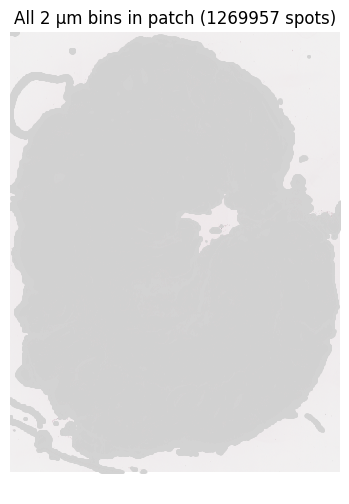

In [52]:
matrix_h5  = "/Users/adyzhang/gvhd_spatial/gvhd-project_VisiumHD_SLV14_binned_outputs_square_002um_filtered_feature_bc_matrix.h5"
pos_parq   = "/Users/adyzhang/gvhd_spatial/gvhd-project_VisiumHD_SLV14_binned_outputs_square_002um_spatial_tissue_positions.parquet"
scale_json = "/Users/adyzhang/gvhd_spatial/gvhd-project_VisiumHD_Original_spaceranger_output_VisiumHD_SLV14_outs_binned_outputs_square_002um_spatial_scalefactors_json.json"
svs_path   = "/Users/adyzhang/gvhd_spatial/#38_C159_1_F1_Slide2.svs"

adata_2um = sc.read_10x_h5(matrix_h5)
adata_2um.var_names_make_unique()
pos = pd.read_parquet(pos_parq).set_index('barcode').loc[adata_2um.obs_names]
coords_visium = pos[['pxl_col_in_fullres','pxl_row_in_fullres']].values.astype(float)
with open(scale_json) as f:
    sf = json.load(f)
coords_hires = coords_visium * sf['tissue_hires_scalef']
adata_2um.obsm['spatial'] = coords_hires

# Define the patch coords
patch_x, patch_y = 4000,  5500    # top‑left corner 
patch_w, patch_h = 9000,  12000    # width & height 

slide = openslide.OpenSlide(svs_path)
patch = slide.read_region((patch_x, patch_y), 0, (patch_w, patch_h)).convert('RGB')

hires_img = adata_slv14.uns['spatial']['SLV14']['images']['hires']
hires_h, hires_w = hires_img.shape[:2]
svs_w, svs_h   = slide.dimensions
scale_x, scale_y = svs_w / hires_w, svs_h / hires_h

# Map coords to full-res .svs space
coords_full  = coords_hires * np.array([scale_x, scale_y])
inside       = (
    (coords_full[:,0] >= patch_x) & (coords_full[:,0] < patch_x + patch_w) &
    (coords_full[:,1] >= patch_y) & (coords_full[:,1] < patch_y + patch_h)
)
coords_local = coords_full[inside] - np.array([patch_x, patch_y])

plt.figure(figsize=(6,6))
plt.imshow(patch)
plt.scatter(coords_local[:,0], coords_local[:,1],
            s=1, c='lightgrey', marker='.', alpha=0.6)
plt.axis('off')
plt.title(f"All 2 µm bins in patch ({inside.sum()} spots)")
plt.show()

# Plot top gene expression
adata_patch = adata_2um[inside].copy()
if sp.issparse(adata_patch.X):
    gene_sums = np.array(adata_patch.X.sum(axis=0)).ravel()
else:
    gene_sums = np.array(adata_patch.X.sum(axis=0))

df = pd.DataFrame({'gene': adata_patch.var_names, 'total': gene_sums})
df = df.sort_values('total', ascending=False).reset_index(drop=True)

# 11) Plot top genes as log-scaled “heat” overlays
top_n         = 10
genes_to_plot = df['gene'].iloc[:top_n].tolist()
Xp            = adata_patch.X

# def plot_gene(ax, gene):
#     idx  = list(adata_patch.var_names).index(gene)
#     expr = (Xp[:,idx].toarray().ravel() if sp.issparse(Xp) else Xp[:,idx])
#     expr = np.log1p(expr)

#     norm = mcolors.Normalize(vmin=0, vmax=0.5)  # manually chosen
#     ax.imshow(patch)
#     ax.scatter(coords_local[:,0], coords_local[:,1],
#                c=expr, cmap='magma', norm=norm,
#                s=10, edgecolors='none', alpha=0.8)
#     ax.set_title(f"{gene} (nonzero = {(expr > 0).sum()})")
#     ax.axis('off')


##### Make sure signature genes are present inside the masked regions


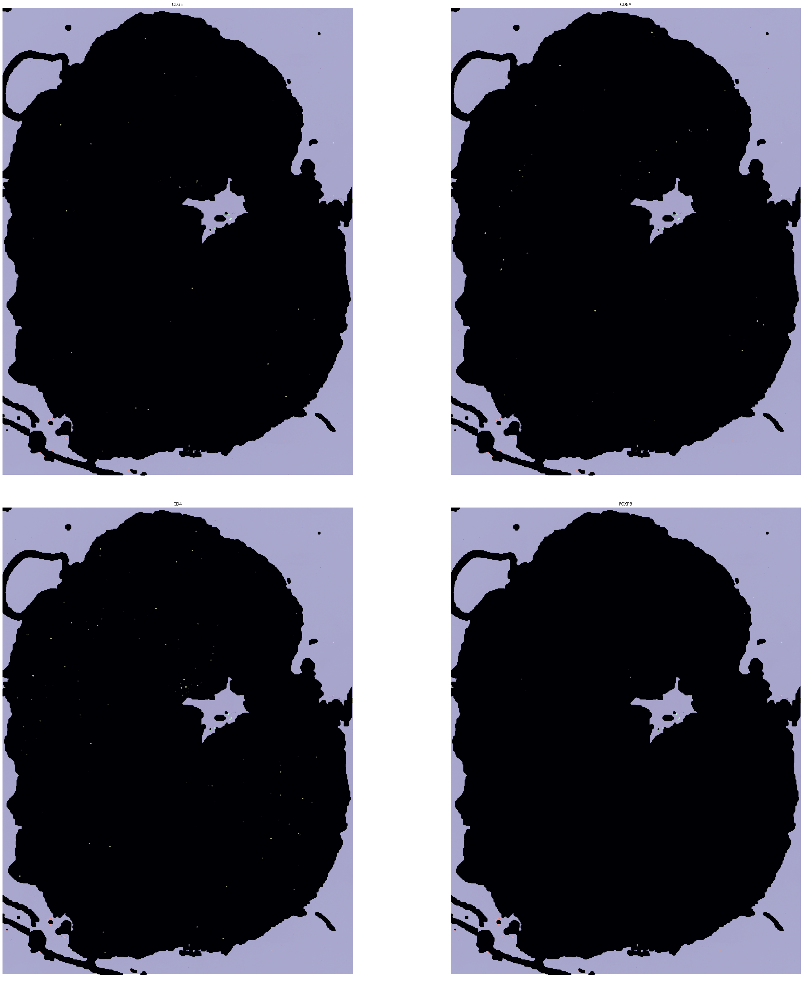

In [53]:
genes_to_plot = ["CD3E", "CD8A", "CD4", "FOXP3"]

def plot_gene(ax, gene):
    idx  = list(adata_patch.var_names).index(gene)
    expr = (Xp[:, idx].toarray().ravel() if sp.issparse(Xp) else Xp[:, idx])
    expr = np.log1p(expr)
    vmax = 1
    norm = mcolors.Normalize(vmin=0, vmax=0.01)

    ax.imshow(patch)
    ax.imshow(full_mask, cmap="jet", alpha=0.3)
    ax.scatter(
        coords_local[:, 0],
        coords_local[:, 1],
        c=expr,
        cmap="magma",
        norm=norm,
        s=20,
        edgecolors="none",
        alpha=0.7
    )
    ax.set_title(gene)
    ax.axis("off")

fig, axes = plt.subplots(2, 2, figsize=(40, 40))

for ax, gene in zip(axes.flatten(), genes_to_plot):
    plot_gene(ax, gene)
plt.tight_layout()
plt.show()

In [54]:
for gene in genes_to_plot:
    idx = list(adata_patch.var_names).index(gene)
    expr = adata_patch.X[:, idx]
    expr = expr.toarray().ravel() if sp.issparse(expr) else expr
    print(f"{gene}: nonzero bins = {(expr > 0).sum()} / {expr.size}")


CD3E: nonzero bins = 144 / 1269957
CD8A: nonzero bins = 181 / 1269957
CD4: nonzero bins = 441 / 1269957
FOXP3: nonzero bins = 25 / 1269957


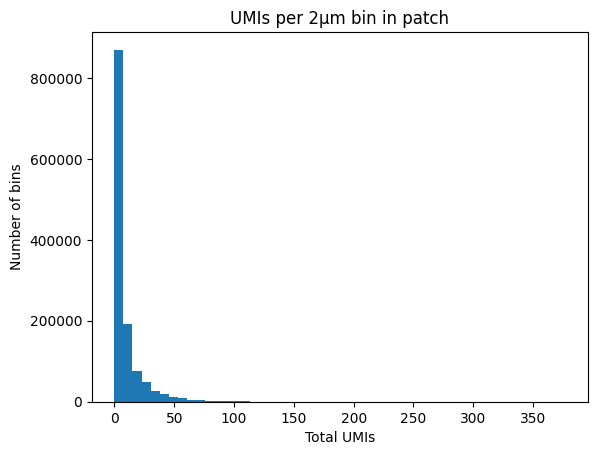

In [46]:
counts = np.array(adata_patch.X.sum(axis=1)).ravel()
plt.hist(counts, bins=50)
plt.title("UMIs per 2µm bin in patch")
plt.xlabel("Total UMIs"); plt.ylabel("Number of bins")
plt.show()

In [47]:
idx = adata_patch.var_names.get_loc("CD3E")
cd3e_counts = (adata_patch.X[:, idx].toarray() if sp.issparse(adata_patch.X) else adata_patch.X[:, idx])
print("Total CD3E UMIs in patch:", cd3e_counts.sum())
print("Bins with any CD3E:", np.count_nonzero(cd3e_counts))

Total CD3E UMIs in patch: 148.0
Bins with any CD3E: 144


##### Assign the spots to each "single cell" segment

In [57]:
# find cell labels inside the patch
coords_int = np.round(coords_local).astype(int)
coords_int[:, 0] = np.clip(coords_int[:, 0], 0, patch_w - 1)
coords_int[:, 1] = np.clip(coords_int[:, 1], 0, patch_h - 1)
labels = full_mask[coords_int[:, 1], coords_int[:, 0]]

in_mask = labels > 0
labels = labels[in_mask]
adata_filtered = adata_patch[in_mask].copy()

# aggregate expression per cell
X_bins = adata_filtered.X

if sp.issparse(X_bins):
    df_expr = pd.DataFrame.sparse.from_spmatrix(
        X_bins,
        index=labels,
        columns=adata_patch.var_names
    )
else:
    df_expr = pd.DataFrame(
        X_bins,
        index=labels,
        columns=adata_patch.var_names
    )

In [58]:
print("adata_patch shape:", adata_patch.shape)        # All bins in the patch
print("coords_local shape:", coords_local.shape)      # All bin coordinates
print("adata_filtered shape:", adata_filtered.shape)  # Only bins inside cells

adata_patch shape: (1269957, 18085)
coords_local shape: (1269957, 2)
adata_filtered shape: (413903, 18085)


In [61]:
# Create the AnnData object
X = adata_filtered.X.tocsr() if sp.issparse(adata_filtered.X) else csr_matrix(adata_filtered.X)

# Map each label to an index
unique_labels, inverse = np.unique(labels, return_inverse=True)
n_cells = len(unique_labels)

X_cell_lil = lil_matrix((n_cells, X.shape[1]), dtype=X.dtype)
for i in range(n_cells):
    rows = np.where(inverse == i)[0]
    X_cell_lil[i] = X[rows].sum(axis=0)
X_cell = X_cell_lil.tocsr()

adata_cells = ad.AnnData(
    X = X_cell,
    obs = pd.DataFrame(index=[f"cell_{i}" for i in unique_labels]),
    var = adata_filtered.var.copy()
)

#### Analysis of the "single cell" gene expression data

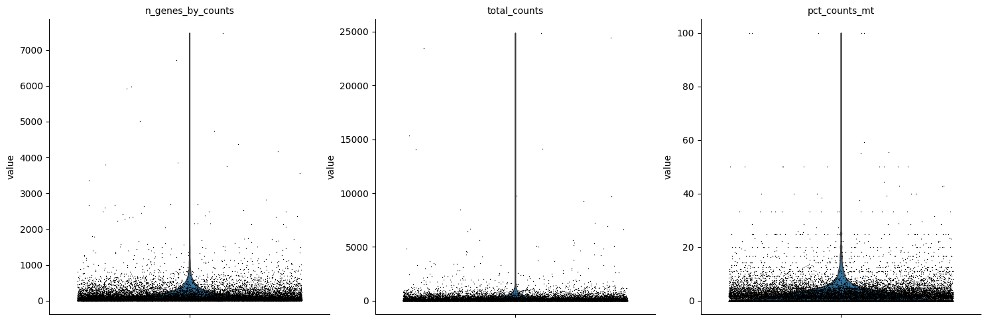

In [62]:
adata_cells.var["mt"] = adata_cells.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(
    adata_cells, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

sc.pl.violin(
    adata_cells,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

In [64]:
# adata_cells.write("adata_cells_left_patch.h5ad")


In [65]:
adata_cells = sc.read_h5ad("adata_cells_left_patch.h5ad")

In [67]:
print(adata_cells)
print(adata_cells.X.max())

AnnData object with n_obs × n_vars = 17584 × 18085
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
928.0


In [68]:
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
sc.tl.pca(adata_cells, n_comps=10, svd_solver="arpack")
sc.pp.neighbors(adata_cells, n_neighbors=25, n_pcs=10)
sc.tl.umap(adata_cells, min_dist=0.1)

/Applications/anaconda3/envs/cellsam/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:243: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


In [69]:
sc.pp.highly_variable_genes(adata_cells, n_top_genes=200, subset=True)
sc.tl.leiden(adata_cells, resolution=0.1)  
sc.tl.rank_genes_groups(adata_cells, groupby='leiden', use_raw=False, method='wilcoxon')
degs_df = sc.get.rank_genes_groups_df(adata_cells, group=None)
degs_df.head(50)

/var/folders/p0/yjqxx7f14kl0h3lf12qf7pjc0000gn/T/ipykernel_21439/3641320546.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.1)


,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,MSR1,0.081627,0.647037,0.934943,0.994456
1,0,WDR97,0.058252,3.050636,0.953548,0.994456
2,0,TNFRSF18,0.030099,0.444429,0.975988,0.994456
3,0,OR52J3,0.019414,2.845812,0.984511,0.994456
4,0,KRTAP9-3,0.019414,3.020901,0.984511,0.994456
5,0,GPR61,0.019414,2.662525,0.984511,0.994456
6,0,MORN5,0.019414,2.976347,0.984511,0.994456
7,0,GPR3,-0.006846,1.178413,0.994537,0.994537
8,0,PALM,-0.007887,0.602152,0.993708,0.994537
9,0,C4orf45,-0.019701,-19.735508,0.984282,0.994456


In [70]:
# Show DEGs by leiden cluster
degs_by_cluster = {
    grp: df.reset_index(drop=True)
    for grp, df in degs_df.groupby('group')
}

print(degs_by_cluster['0'].head())
for cluster, df in degs_by_cluster.items():
    print(f"\nCluster {cluster}:")
    print(df[['names','logfoldchanges','pvals_adj']].head(5))

  group     names    scores  logfoldchanges     pvals  pvals_adj
0     0      MSR1  0.081627        0.647037  0.934943   0.994456
1     0     WDR97  0.058252        3.050636  0.953548   0.994456
2     0  TNFRSF18  0.030099        0.444429  0.975988   0.994456
3     0    OR52J3  0.019414        2.845812  0.984511   0.994456
4     0  KRTAP9-3  0.019414        3.020901  0.984511   0.994456

Cluster 0:
      names  logfoldchanges  pvals_adj
0      MSR1        0.647037   0.994456
1     WDR97        3.050636   0.994456
2  TNFRSF18        0.444429   0.994456
3    OR52J3        2.845812   0.994456
4  KRTAP9-3        3.020901   0.994456

Cluster 1:
   names  logfoldchanges      pvals_adj
0  CLDN4        4.211145  3.409826e-114
1  TPD52        4.088716   2.852866e-62
2  NPDC1        2.116663   1.288496e-45
3  PRSS8        3.920731   2.910770e-39
4  CALM2        3.135207   4.123969e-35

Cluster 2:
     names  logfoldchanges  pvals_adj
0      HBB        1.371373   0.999727
1    CXCL6        0.7712

/var/folders/p0/yjqxx7f14kl0h3lf12qf7pjc0000gn/T/ipykernel_21439/949411084.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for grp, df in degs_df.groupby('group')


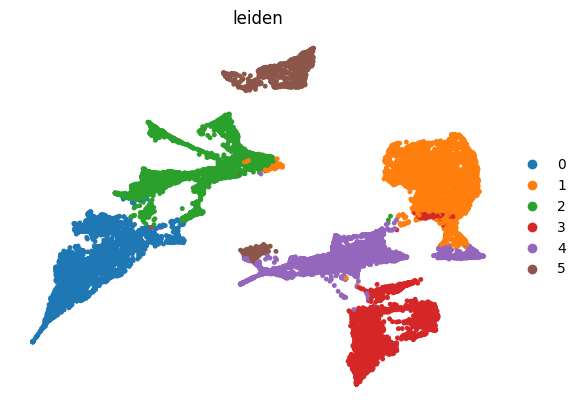

In [71]:
sc.pl.umap(
    adata_cells,
    color="leiden",
    size=50,
    frameon=False
)

##### Visualize signatures on UMAPs

In [ ]:
# Load full gene matrix
adata_cells = sc.read_h5ad("adata_cells_left_patch.h5ad")
adata_cells = adata_cells[adata_cells.X.sum(1).A1 > 0].copy() # remove empty cells


In [11]:
adata_cells

AnnData object with n_obs × n_vars = 17527 × 18085
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [12]:
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.raw = adata_cells.copy()
sc.pp.highly_variable_genes(adata_cells, n_top_genes=2000, subset=True)

/Applications/anaconda3/envs/cellsam/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/Applications/anaconda3/envs/cellsam/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/Applications/anaconda3/envs/cellsam/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:463: P

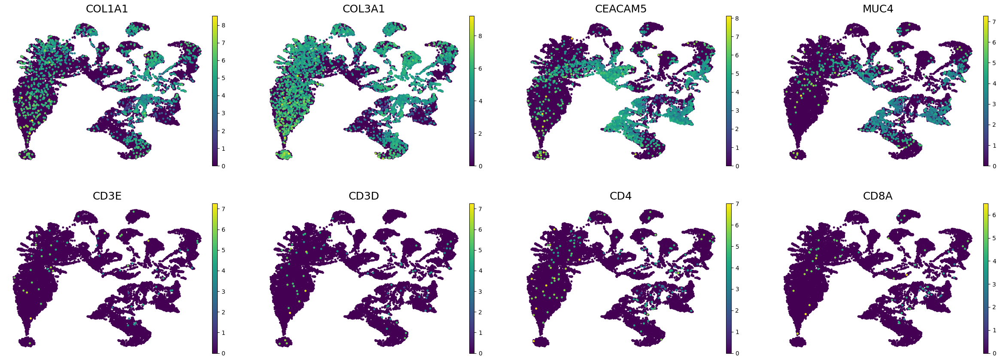

In [ ]:
plt.rcParams["axes.titlesize"] = 18   

sc.tl.pca(adata_cells, n_comps=10)
sc.pp.neighbors(adata_cells, n_neighbors=25, n_pcs=10)
sc.tl.umap(adata_cells)
sc.tl.leiden(adata_cells, resolution=0.5)

# DEG analysis
sc.tl.rank_genes_groups(adata_cells, groupby='leiden', use_raw=True, method='wilcoxon')
sc.pl.umap(
    adata_cells,
    color = ["COL1A1", "COL3A1", "CEACAM5", "MUC4", "CD3E", "CD3D", "CD4", "CD8A"], 
    use_raw=True, 
    size=50,
    frameon=False
)